In [33]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2

In [34]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_box(box, ax):
    x0, y0, x1, y1 = box
    w, h = x1 - x0, y1 - y0
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

# for full image segmentation
def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)

In [35]:
# Loading the SAM model and predictor
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

# vit_b model checkpoint
sam_checkpoint_vitb = "../../experiments/checkpoints/sam_vit_b_01ec64.pth"
model_type = "vit_b"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint_vitb)
sam.to(device=device)

# Predictor for prompts
predictor = SamPredictor(sam)

C:\Users\LarsBroertjes\Documents\GitHub\thesis\.venv\lib\site-packages\segment_anything\build_sam.py:105: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.lo

In [199]:
# Load the image
#imageid = "201000195_0067_01_0118_P00_01.jpg"
#imageid = "201000176_0067_01_0137_P00_01.jpg"
#imageid = "201000177_0067_01_0136_P00_01.jpg"
#imageid = "201000178_0067_01_0135_P00_01.jpg"
#imageid = "201000179_0067_01_0134_P00_01.jpg"
#imageid = "201000180_0067_01_0133_P00_01.jpg"
#imageid = "201000181_0067_01_0132_P00_01.jpg"
#imageid = "201000182_0067_01_0131_P00_01.jpg"
#imageid = "201000183_0067_01_0130_P00_01.jpg"
#imageid = "201000184_0067_01_0129_P00_01.jpg"
##imageid = "201000185_0067_01_0128_P00_01.jpg"
#imageid = "201000186_0067_01_0127_P00_01.jpg"
#imageid = "201000187_0067_01_0126_P00_01.jpg"
#imageid = "201000188_0067_01_0125_P00_01.jpg"
#imageid = "201000189_0067_01_0124_P00_01.jpg"
#imageid = "201000190_0067_01_0123_P00_01.jpg"
#imageid = "201000191_0067_01_0122_P00_01.jpg"
#imageid = "201000192_0067_01_0121_P00_01.jpg"
#imageid = "201000193_0067_01_0120_P00_01.jpg"
imageid = "183000423_0069_01_0128_P00_01.jpg"

image = cv2.imread("../../data/experimental/building_classes/multiple/" + imageid)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

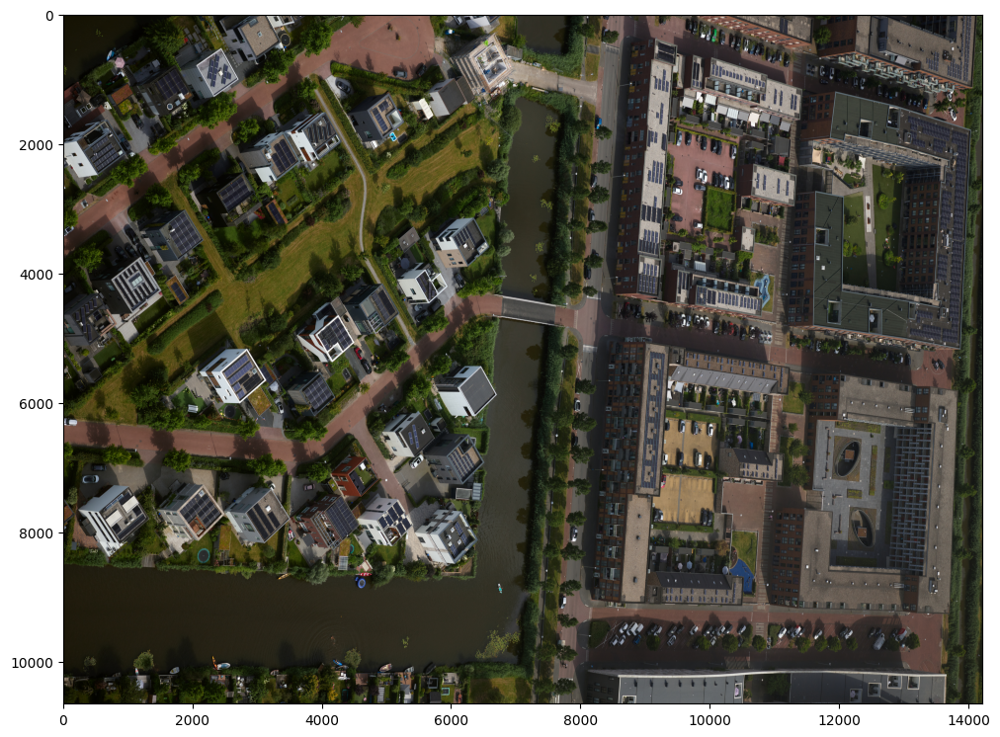

In [200]:
# Show the image
plt.figure(figsize=(12,10))
plt.imshow(image)
plt.axis('on')
plt.show()

### Import prompt list for imageid from PostgreSQL database

In [201]:
import psycopg2
import os

In [202]:
# Database configuration
DB_CONFIG = {
    "dbname" : "BagMapDB",
    "user" : "postgres",
    "password" : os.getenv("DB_PASSWORD"),
    "host" : "localhost",
    "port" : "5432"
}

# Connect to the database
conn = psycopg2.connect(**DB_CONFIG)
cursor = conn.cursor()

cursor.execute("SELECT bag_ids, bboxes FROM bag_in_image_utrecht WHERE image_name = %s;", (imageid,))

result = cursor.fetchone()

cursor.close()
conn.close()

if result:
    bag_ids = result[0]  # List of bag IDs
    bboxes_wkt = result[1]  # List of WKT polygons



In [208]:
def wkt_to_bbox(wkt):
    coords = wkt.replace("POLYGON((", "").replace("))", "").split(", ")
    x_vals = []
    y_vals = []
    for coord in coords:
        x, y = map(float, coord.split())
        x_vals.append(x)
        y_vals.append(y)
    return [min(x_vals), min(y_vals), max(x_vals), max(y_vals)]

bboxes = [wkt_to_bbox(wkt) for wkt in bboxes_wkt]
input_boxes = torch.tensor(bboxes, device=device)
print(len(bboxes))
print(len(input_boxes))

def transform_bounding_boxes(boxes, img_width, img_height):
    transformed_boxes = []

    for box in boxes:
        x_min, y_min, x_max, y_max = box

        # Step 1: Rotate 90 degrees clockwise
        new_x_min = y_min
        new_y_min = img_width - x_max
        new_x_max = y_max
        new_y_max = img_width - x_min

        # Step 2: Flip vertically
        final_x_min = new_x_min
        final_y_min = img_height - new_y_max
        final_x_max = new_x_max
        final_y_max = img_height - new_y_min

        # Step 3: Shift downward (if boxes are too high)
        shift_down = img_height / 3.1  # Shift down by half the image height
        final_y_min += shift_down
        final_y_max += shift_down

        transformed_boxes.append([final_x_min - 20, final_y_min - 20, final_x_max + 300, final_y_max + 20])

    return transformed_boxes

def get_unique_filename(output_dir, filename):
    # Create a unique filename by appending a counter or timestamp if the file already exists
    base_name, ext = os.path.splitext(filename)
    counter = 1
    while os.path.exists(os.path.join(output_dir, filename)):
        filename = f"{base_name}_{counter}{ext}"
        counter += 1
    return filename

input_boxes = transform_bounding_boxes(input_boxes.cpu().numpy(), image.shape[1], image.shape[0])

98
98


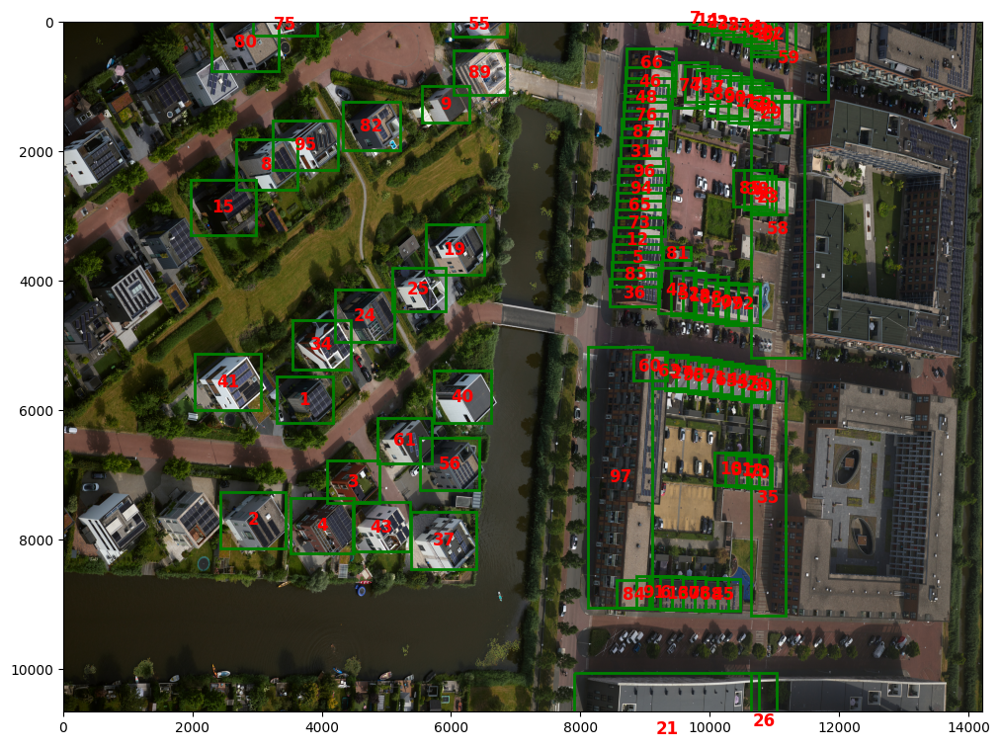

In [209]:
plt.figure(figsize=(12,10))
plt.imshow(image)

for i, box in enumerate(input_boxes):
    show_box(box, plt.gca())  # Ensure show_box() takes (x_min, y_min, x_max, y_max)

    # Get the center of the bounding box
    x_min, y_min, x_max, y_max = box
    center_x = (x_min + x_max) / 2
    center_y = (y_min + y_max) / 2

    # Plot the number
    plt.text(center_x, center_y, str(i+1), color='red', fontsize=12, weight='bold', ha='center', va='center')

plt.axis('on')
plt.show()

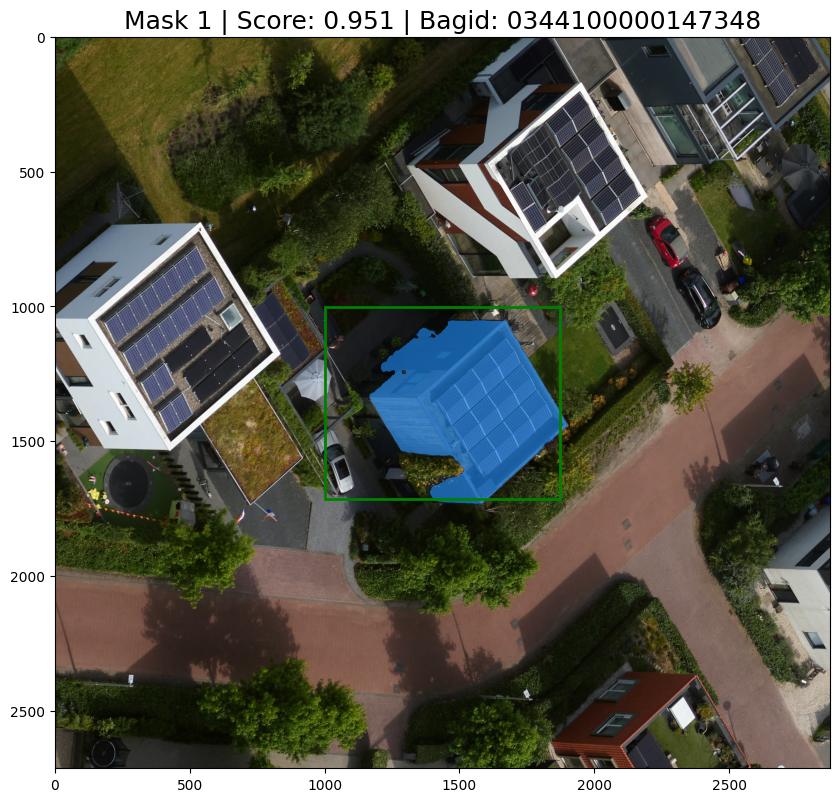

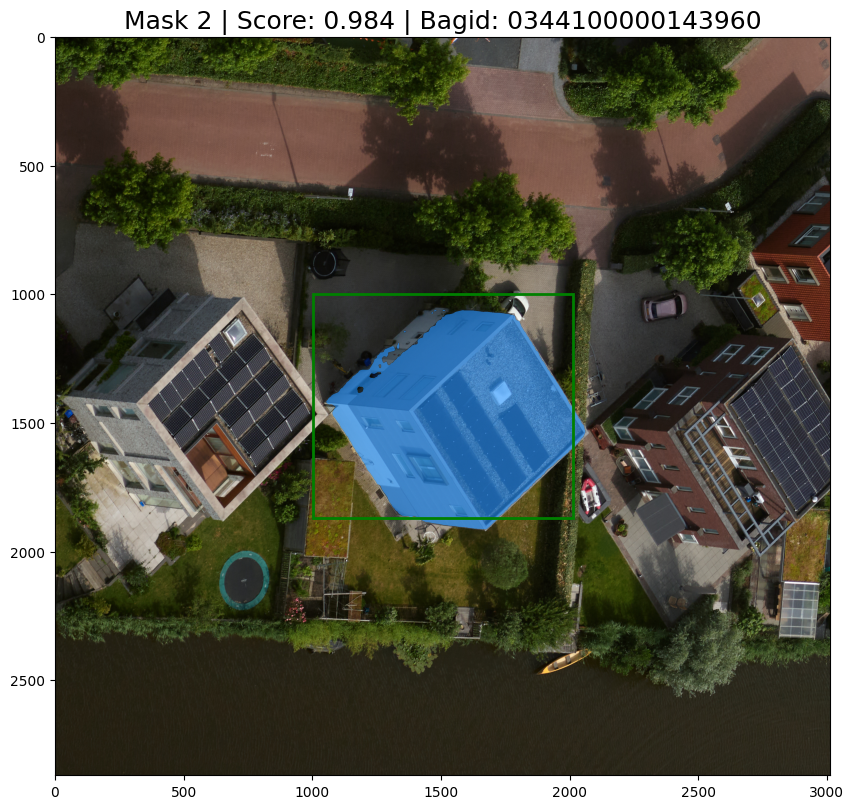

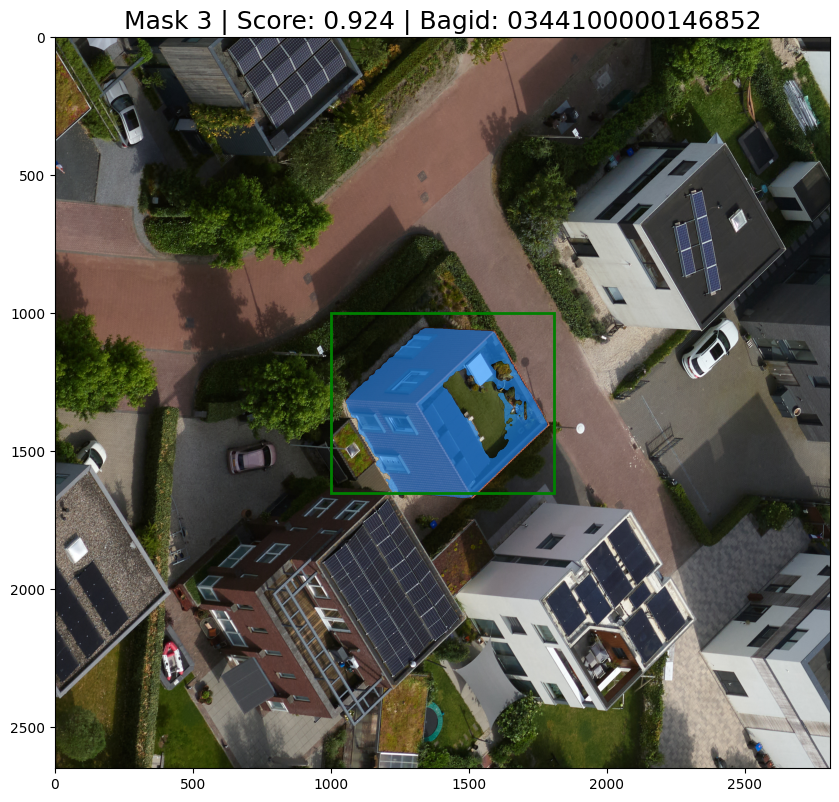

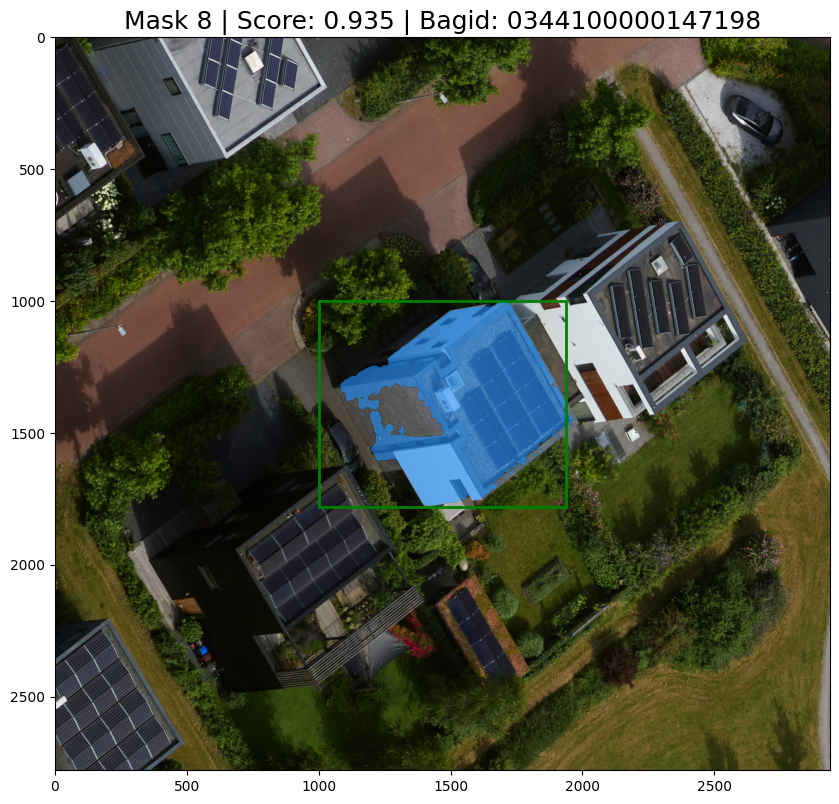

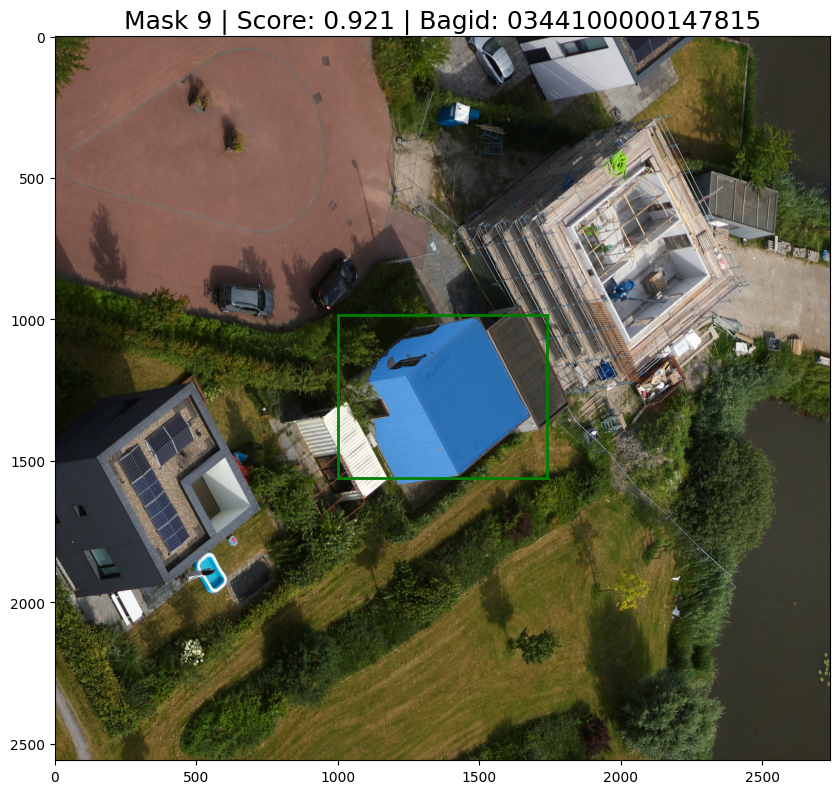

...

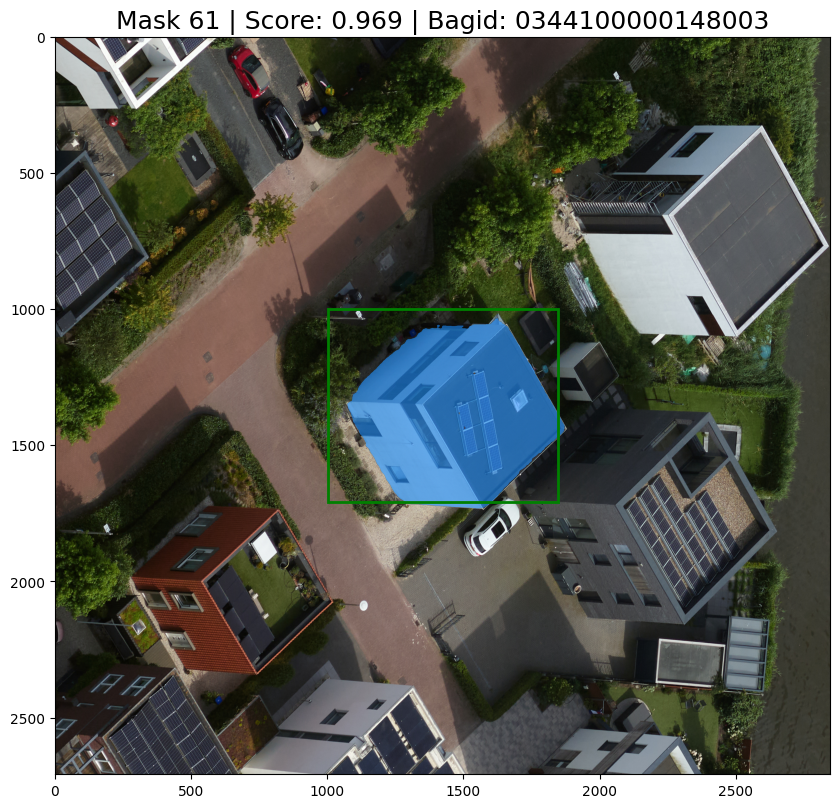

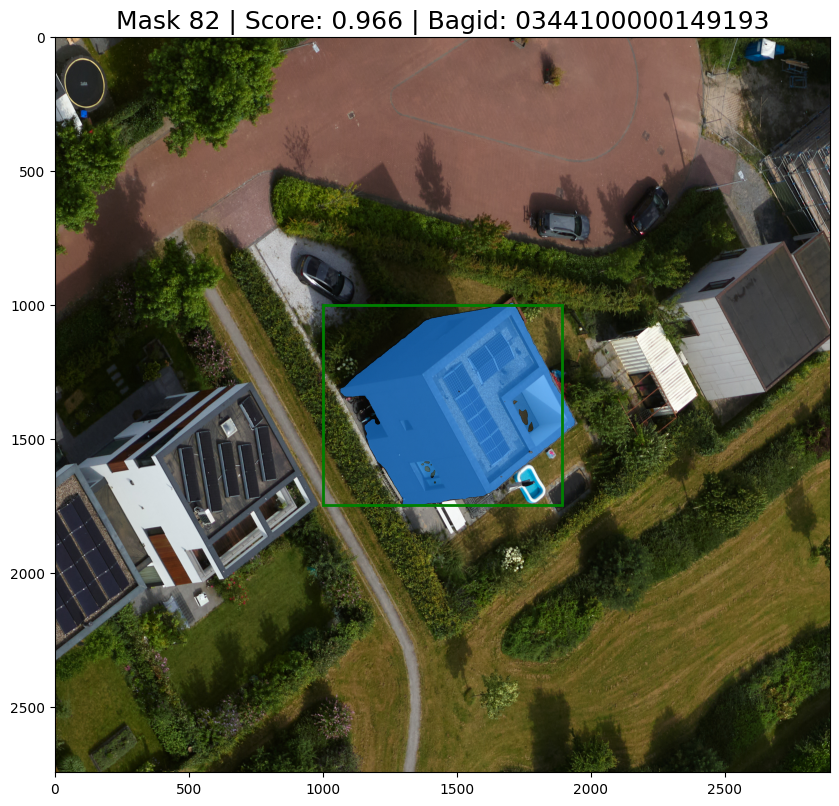

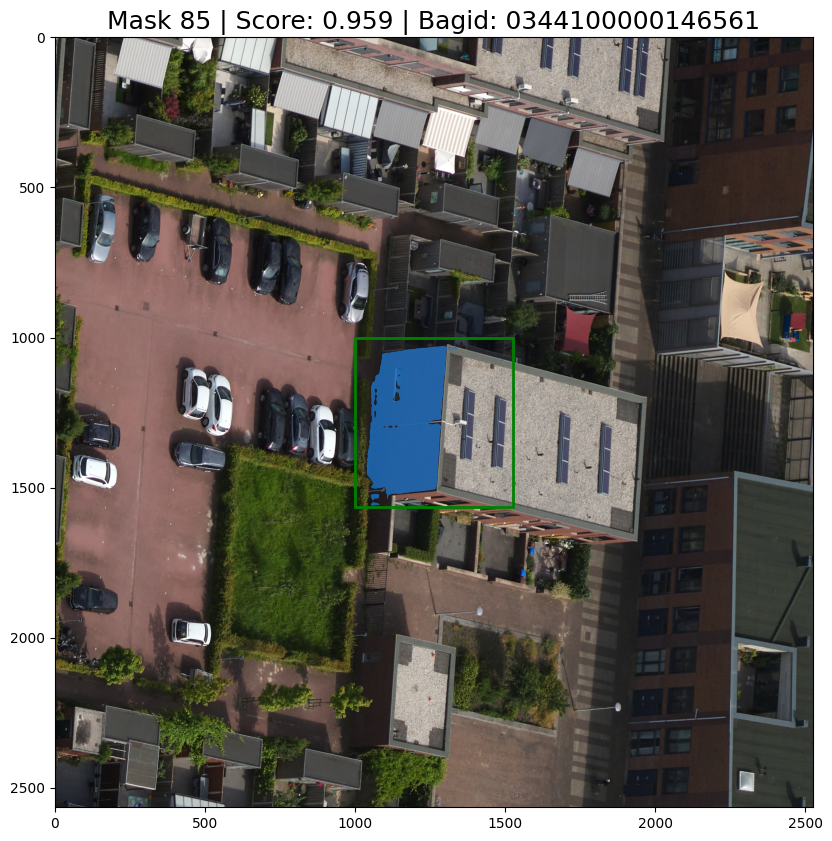

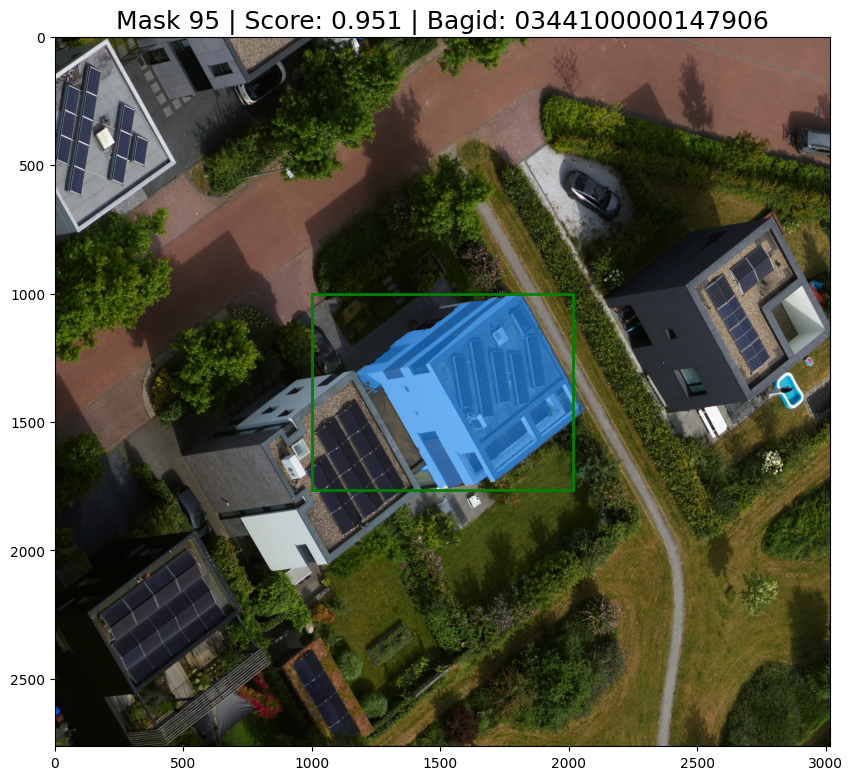

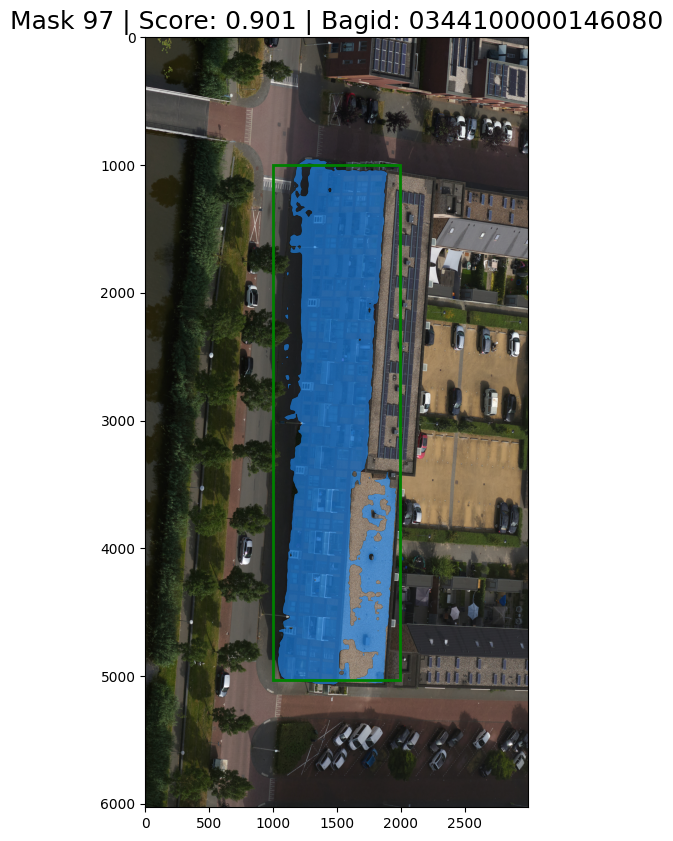

In [210]:
buffer_size = 1000  # Buffer around the bounding box

for i, box in enumerate(input_boxes):
        xmin, ymin, xmax, ymax = box

        # Expand bounding box with buffer
        x_min_buff = max(0, int(xmin) - buffer_size)
        y_min_buff = max(0, int(ymin) - buffer_size)
        x_max_buff = min(image.shape[1], int(xmax) + buffer_size)
        y_max_buff = min(image.shape[0], int(ymax) + buffer_size)

        # Crop image around the buffered bounding box
        cropped_image = image[y_min_buff:y_max_buff, x_min_buff:x_max_buff]

        predictor.set_image(cropped_image)

        # Define prompt box relative to cropped image
        prompt_box = np.array([
            max(0, xmin - x_min_buff),
            max(0, ymin - y_min_buff),
            max(0, xmax - x_min_buff),
            max(0, ymax - y_min_buff)
        ], dtype=np.float32)

        # Run segmentation on the cropped image
        masks, scores, _ = predictor.predict(box=prompt_box, multimask_output=False)

        if scores[0] > 0.9:
            # Display results: Show only the cropped image after segmentation
            plt.figure(figsize=(10, 10))
            plt.imshow(cropped_image)
            show_mask(masks[0], plt.gca())  # Show segmentation mask on cropped image
            show_box(prompt_box, plt.gca())  # Show the current bounding box on cropped image
            plt.title(f"Mask {i+1} | Score: {scores[0]:.3f} | Bagid: {bag_ids[i]}", fontsize=18)
            plt.show()

            # Save the mask to the specified path
            output_dir = f"../../data/outputs/bagids/{bag_ids[i]}"
            os.makedirs(output_dir, exist_ok=True)

            mask = masks[0].astype(np.uint8)  # Convert mask to binary

            # Resize mask back to full image space
            #full_mask = np.zeros_like(image[:, :, 0], dtype=np.uint8)
            #full_mask[y_min_buff:y_max_buff, x_min_buff:x_max_buff] = mask

            # Apply the full mask to the original image
            #masked_image = cv2.bitwise_and(image, image, mask=full_mask)
            masked_image = cv2.bitwise_and(cropped_image, cropped_image, mask=mask)

            masked_filename = f"{bag_ids[i]}_masked.jpg"
            masked_filename = get_unique_filename(output_dir, masked_filename)

            # Save the masked image
            masked_output_path = os.path.join(output_dir, masked_filename)
            cv2.imwrite(masked_output_path, masked_image)
